In [1]:
import torch
from torch import nn 
import torch.nn.functional as F
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader

import os
import matplotlib.pyplot as plt
from PIL import Image
from skimage.color import rgb2lab, lab2rgb
import numpy as np
from tqdm import tqdm

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [3]:
device

'cpu'

In [4]:
lab_transformer = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

gray_transformer = transforms.Compose([
    transforms.Resize((384, 384)),
    transforms.ToTensor()
])

In [5]:
class CustomDataset(Dataset):
    def __init__(self, path, lab_transformer=None, gray_transformer=None):
        self.path = path
        self.img_list = sorted(os.listdir(self.path))
        self.lab_transformer = lab_transformer
        self.gray_transformer = gray_transformer
    def __len__(self):
        return len(self.img_list)
    def __getitem__(self, idx):
        img = os.path.join(self.path, self.img_list[idx])
        img = Image.open(img).convert("RGB")
        gray_image = img.convert("L").convert("RGB")

        if self.lab_transformer:
            img = self.lab_transformer(img)
            
        if self.gray_transformer:
            gray_image = self.gray_transformer(gray_image)

        
        img = img.permute(1, 2, 0).numpy()
        lab_img = rgb2lab(img)

        l_channel = lab_img[:, :, 0] / 100.0

        l_channel = torch.tensor(l_channel, dtype=torch.float32).unsqueeze(0)
        
        # gray_image = gray_image.unsqueeze(0)

        return l_channel, gray_image


In [6]:
link = "/kaggle/input/test-grayscaled-images/grayscaled_images"
dataset = CustomDataset(link, lab_transformer=lab_transformer, gray_transformer=gray_transformer)
dl = DataLoader(dataset, batch_size=1, shuffle=False, generator=torch.Generator(device="cpu"))

In [7]:
x, y = next(iter(dl))
print(x.shape, y.shape)
  

torch.Size([1, 1, 256, 256]) torch.Size([1, 3, 384, 384])


In [66]:
class SEBlock(nn.Module):
    def __init__(self, C, r=16):
        super().__init__()

        self.aap = nn.AdaptiveAvgPool2d((1, 1))
        self.flatten = nn.Flatten()

        self.linear1 = nn.Linear(C, C // r)
        self.linear2 = nn.Linear(C // r, C)

        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        out = self.aap(x)
        out = self.flatten(out)

        out = self.relu(self.linear1(out))
        out = self.sigmoid(self.linear2(out))

        out = out[:, :, None, None]

        res = out * x
        return res


class SE_ResBlock(nn.Module):
    def __init__(self, inputs, outputs, kernel, stride):
        super().__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=1),
            nn.BatchNorm2d(outputs),
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(outputs, outputs, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(outputs),
        )

        if inputs != outputs:
            self.add_conv = nn.Sequential(
                nn.Conv2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=1),
                nn.BatchNorm2d(outputs),
            )

        self.se_block = SEBlock(outputs)

    def forward(self, x):
        out = self.conv1(x)
        add_out = self.add_conv(x)

        out = F.leaky_relu(out)
        out = self.conv2(out)
        out = self.se_block(out)

        out += add_out

        out = F.leaky_relu(out)

        return out


class SEBLock(nn.Module):
    def __init__(self, C, r=16):
        super().__init__()

        self.app = nn.AdaptiveAvgPool2d((1, 1))
        self.flatten = nn.Flatten()

        self.linear1 = nn.Linear(C, C//r)
        self.linear2 = nn.Linear(C//r, C)

        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        out = self.app(x)
        out = self.flatten(out)

        out = self.linear1(out)
        out = self.relu(out)

        out = self.linear2(out)
        out = self.sigmoid(out)

        out = out[:, :, None, None]

        res = out * x

        return res

In [67]:
class Model1(nn.Module):
    def __init__(self, inputs=1, outputs=2):
        super().__init__()

        self.conv1 = SE_ResBlock(inputs, 32, kernel=4, stride=2)
        self.conv2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )

        # self.emb = nn.Sequential(
        #     SE_ResBlock(1024, 512, kernel=3, stride=1),
        # )

        self.conv6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv5 = nn.ConvTranspose2d(3, outputs, kernel_size=3, stride=1, padding=1)

        self.linear_block = nn.Sequential(
            nn.LeakyReLU(),
            nn.Linear(2048, 512)
        )

        # ----------------------------------------------------------------------------------------------------------------

        self.conv2_1 = SE_ResBlock(inputs, 32, kernel=4, stride=2)
        self.conv2_2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv2_3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv2_4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv2_5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )

        # self.emb = nn.Sequential(
        #     SE_ResBlock(1024, 512, kernel=3, stride=1),
        # )

        self.conv2_6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv2_1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv2_2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv2_3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv2_4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv2_5 = nn.ConvTranspose2d(3, outputs, kernel_size=3, stride=1, padding=1)

        # ------------------------------------------------------------------------------------

        self.conv3_1 = SE_ResBlock(4, 32, kernel=4, stride=2)
        self.conv3_2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv3_3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv3_4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv3_5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )

        self.conv3_6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv3_1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv3_2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv3_3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv3_4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv3_5 = nn.ConvTranspose2d(6, outputs, kernel_size=3, stride=1, padding=1)

    def forward(self, x, embadding=None, return_latent=False):
        x1 = self.conv1(x)
        x2 = self.conv2(x1)
        x3 = self.conv3(x2)
        x4 = self.conv4(x3)

        x5 = self.conv5(x4)

        if embadding is not None:
            embadding_tensor = self.linear_block(embadding)

            embadding_tensor = embadding_tensor.unsqueeze(-1).unsqueeze(-1)
            embadding_tensor = embadding_tensor.expand(-1, -1, x5.size(2), x5.size(3))
        else:
            print("No embedding provided.")
            embadding_tensor = torch.zeros(x5.size(0), 512, x5.size(2), x5.size(3)).to(device)

        # x5 = torch.concat((embadding_tensor, x5), dim=1)
        # x5 = self.emb(x5)

        x5 += embadding_tensor

        if return_latent == True:
            return x5

        x6 = self.conv6(x5)

        x7 = torch.cat((x6, x4), 1)
        x7 = self.t_conv1(x7)

        x8 = torch.cat((x7, x3), 1)
        x8 = self.t_conv2(x8)

        x9 = torch.cat((x8, x2), 1)
        x9 = self.t_conv3(x9)

        x10 = torch.cat((x9, x1), 1)
        x10 = self.t_conv4(x10)

        x11 = torch.cat((x10, x), 1)
        x11 = F.tanh(self.t_conv5(x11))

        # -----------------------------------------------

        x2_1 = self.conv2_1(x)
        x2_2 = self.conv2_2(x2_1)
        x2_3 = self.conv2_3(x2_2)
        x2_4 = self.conv2_4(x2_3)

        x2_5 = self.conv2_5(x2_4)

        x2_6 = self.conv2_6(x2_5)

        x2_7 = torch.cat((x2_6, x2_4), 1)
        x2_7 = self.t_conv2_1(x2_7)

        x2_8 = torch.cat((x2_7, x2_3), 1)
        x2_8 = self.t_conv2_2(x2_8)

        x2_9 = torch.cat((x2_8, x2_2), 1)
        x2_9 = self.t_conv2_3(x2_9)

        x2_10 = torch.cat((x2_9, x2_1), 1)
        x2_10 = self.t_conv2_4(x2_10)

        x2_11 = torch.cat((x2_10, x), 1)
        x2_11 = F.tanh(self.t_conv2_5(x2_11))

        x3 = torch.cat((x11, x2_11), 1)

        # ------------------------------------------------------

        x3_1 = self.conv3_1(x3)
        x3_2 = self.conv3_2(x3_1)
        x3_3 = self.conv3_3(x3_2)
        x3_4 = self.conv3_4(x3_3)

        x3_5 = self.conv3_5(x3_4)

        x3_6 = self.conv3_6(x3_5)

        x3_7 = torch.cat((x3_6, x3_4), 1)
        x3_7 = self.t_conv3_1(x3_7)

        x3_8 = torch.cat((x3_7, x3_3), 1)
        x3_8 = self.t_conv3_2(x3_8)

        x3_9 = torch.cat((x3_8, x3_2), 1)
        x3_9 = self.t_conv3_3(x3_9)

        x3_10 = torch.cat((x3_9, x3_1), 1)
        x3_10 = self.t_conv3_4(x3_10)

        x3_11 = torch.cat((x3_10, x3), 1)
        res = F.tanh(self.t_conv3_5(x3_11))

        return res

    def predict(self, l_channel, rgb_image=None):
        self.eval()

        with torch.no_grad():
            if rgb_image is not None:
                ab_channels = self.forward(l_channel, embadding=rgb_image)
            else:
                ab_channels = self.forward(l_channel)

        l_channel = l_channel.squeeze(0).permute(1, 2, 0).squeeze(2).cpu().numpy()
        # l_channel =  l_channel.permute(1, 2, 0).cpu().numpy()
        ab_channels = ab_channels.squeeze(0).permute(1, 2, 0).cpu().numpy()

        a_channel = ab_channels[:, :, 0]
        b_channel = ab_channels[:, :, 1]

        l_channel = np.clip(l_channel * 100, 0, 100).astype(np.uint8)
        a_channel = np.clip(a_channel * 128, -128, 127).astype(np.int8)
        b_channel = np.clip(b_channel * 128, -128, 127).astype(np.int8)

        lab_image = np.stack([l_channel, a_channel, b_channel], axis=-1).astype(np.float64)
        rgb_image = lab2rgb(lab_image)

        rgb_image = np.clip(rgb_image * 255, 0, 255).astype(np.uint8)

        # rgb_image =  np.clip(rgb_image, 0, 1).astype(np.uint8)

        return rgb_image


In [68]:
class Model2(nn.Module):
    def __init__(self, inputs=1, outputs=2):
        super().__init__()

        self.conv1 = SE_ResBlock(inputs, 32, kernel=4, stride=2)
        self.conv2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )


        self.conv6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv5 = nn.ConvTranspose2d(3, outputs, kernel_size=3, stride=1, padding=1)

        # self.linear_block = nn.Sequential(
        #     nn.LeakyReLU(),
        #     nn.Linear(emb_size, 512)
        # )

        # ----------------------------------------------------------------------------------------------------------------

        self.conv2_1 = SE_ResBlock(inputs, 32, kernel=4, stride=2)
        self.conv2_2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv2_3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv2_4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv2_5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )

        # self.emb = nn.Sequential(
        #     SE_ResBlock(1024, 512, kernel=3, stride=1),
        # )

        self.conv2_6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv2_1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv2_2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv2_3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv2_4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv2_5 = nn.ConvTranspose2d(3, outputs, kernel_size=3, stride=1, padding=1)

        # ------------------------------------------------------------------------------------

        self.conv3_1 = SE_ResBlock(4, 32, kernel=4, stride=2)
        self.conv3_2 = SE_ResBlock(32, 64, kernel=4, stride=2)
        self.conv3_3 = SE_ResBlock(64, 128, kernel=4, stride=2)
        self.conv3_4 = SE_ResBlock(128, 256, kernel=4, stride=2)

        self.conv3_5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU()
        )

        self.conv3_6 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=2, dilation=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU()
        )

        self.t_conv3_1 = nn.Sequential(
            nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU()
        )
        self.t_conv3_2 = nn.Sequential(
            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU()
        )

        self.t_conv3_3 = nn.Sequential(
            nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU()
        )

        self.t_conv3_4 = nn.Sequential(
            nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU()
        )
        self.t_conv3_5 = nn.ConvTranspose2d(6, outputs, kernel_size=3, stride=1, padding=1)

    def forward(self, x, embadding=None, return_latent=False):
        x1 = self.conv1(x)
        x2 = self.conv2(x1)
        x3 = self.conv3(x2)
        x4 = self.conv4(x3)

        x5 = self.conv5(x4)

        if embadding is not None:
            # if embadding.size(1) != 512:
            #     embadding = self.linear_block(embadding)

            embadding_tensor = embadding.unsqueeze(-1).unsqueeze(-1)
            embadding_tensor = embadding_tensor.expand(-1, -1, x5.size(2), x5.size(3))
        else:
            print("No embedding provided.")
            embadding_tensor = torch.zeros(x5.size(0), 512, x5.size(2), x5.size(3)).to(device)

        # x5 = torch.concat((embadding_tensor, x5), dim=1)
        # x5 = self.emb(x5)

        x5 += embadding_tensor

        if return_latent == True:
            return x5

        x6 = self.conv6(x5)

        x7 = torch.cat((x6, x4), 1)
        x7 = self.t_conv1(x7)

        x8 = torch.cat((x7, x3), 1)
        x8 = self.t_conv2(x8)

        x9 = torch.cat((x8, x2), 1)
        x9 = self.t_conv3(x9)

        x10 = torch.cat((x9, x1), 1)
        x10 = self.t_conv4(x10)

        x11 = torch.cat((x10, x), 1)
        x11 = F.tanh(self.t_conv5(x11))

        # -----------------------------------------------

        x2_1 = self.conv2_1(x)
        x2_2 = self.conv2_2(x2_1)
        x2_3 = self.conv2_3(x2_2)
        x2_4 = self.conv2_4(x2_3)

        x2_5 = self.conv2_5(x2_4)

        x2_6 = self.conv2_6(x2_5)

        x2_7 = torch.cat((x2_6, x2_4), 1)
        x2_7 = self.t_conv2_1(x2_7)

        x2_8 = torch.cat((x2_7, x2_3), 1)
        x2_8 = self.t_conv2_2(x2_8)

        x2_9 = torch.cat((x2_8, x2_2), 1)
        x2_9 = self.t_conv2_3(x2_9)

        x2_10 = torch.cat((x2_9, x2_1), 1)
        x2_10 = self.t_conv2_4(x2_10)

        x2_11 = torch.cat((x2_10, x), 1)
        x2_11 = F.tanh(self.t_conv2_5(x2_11))

        x3 = torch.cat((x11, x2_11), 1)

        # ------------------------------------------------------

        x3_1 = self.conv3_1(x3)
        x3_2 = self.conv3_2(x3_1)
        x3_3 = self.conv3_3(x3_2)
        x3_4 = self.conv3_4(x3_3)

        x3_5 = self.conv3_5(x3_4)

        x3_6 = self.conv3_6(x3_5)

        x3_7 = torch.cat((x3_6, x3_4), 1)
        x3_7 = self.t_conv3_1(x3_7)

        x3_8 = torch.cat((x3_7, x3_3), 1)
        x3_8 = self.t_conv3_2(x3_8)

        x3_9 = torch.cat((x3_8, x3_2), 1)
        x3_9 = self.t_conv3_3(x3_9)

        x3_10 = torch.cat((x3_9, x3_1), 1)
        x3_10 = self.t_conv3_4(x3_10)

        x3_11 = torch.cat((x3_10, x3), 1)
        res = F.tanh(self.t_conv3_5(x3_11))

        return res

    def predict(self, l_channel, rgb_image=None):
        self.eval()

        with torch.no_grad():
            if rgb_image is not None:
                ab_channels = self.forward(l_channel, embadding=rgb_image)
            else:
                ab_channels = self.forward(l_channel)

        l_channel = l_channel.squeeze(0).permute(1, 2, 0).squeeze(2).cpu().numpy()
        # l_channel =  l_channel.permute(1, 2, 0).cpu().numpy()
        ab_channels = ab_channels.squeeze(0).permute(1, 2, 0).cpu().numpy()

        a_channel = ab_channels[:, :, 0]
        b_channel = ab_channels[:, :, 1]

        l_channel = np.clip(l_channel * 100, 0, 100).astype(np.uint8)
        a_channel = np.clip(a_channel * 128, -128, 127).astype(np.int8)
        b_channel = np.clip(b_channel * 128, -128, 127).astype(np.int8)

        lab_image = np.stack([l_channel, a_channel, b_channel], axis=-1).astype(np.float64)
        rgb_image = lab2rgb(lab_image)

        rgb_image = np.clip(rgb_image * 255, 0, 255).astype(np.uint8)

        # rgb_image =  np.clip(rgb_image, 0, 1).astype(np.uint8)

        return rgb_image

In [69]:
class Model3(nn.Module):
    def __init__(self, inputs=1, outputs=2):
        super().__init__()

        self.conv1 = nn.Conv2d(inputs, 32, kernel_size=4, stride=2, padding=1)
        self.bnorm1 = nn.BatchNorm2d(32)
        self.seblock1 = SEBLock(32)

        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.bnorm2 = nn.BatchNorm2d(64)
        self.seblock2 = SEBLock(64)

        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.bnorm3 = nn.BatchNorm2d(128)
        self.seblock3 = SEBLock(128)

        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)
        self.bnorm4 = nn.BatchNorm2d(256)
        self.seblock4 = SEBLock(256)

        self.btn_conv5 = nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=3, dilation=2)
        self.bnorm5 = nn.BatchNorm2d(512)
        self.seblock5 = SEBLock(512)

        self.btn_conv6 = nn.Conv2d(512, 256, kernel_size=4, stride=1, padding=3, dilation=2)
        self.bnorm6 = nn.BatchNorm2d(256)
        self.seblock6 = SEBLock(256)

        self.t_conv1 = nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1)
        self.t_bnorm1 = nn.BatchNorm2d(128)
        self.seblock7 = SEBLock(128)

        self.t_conv2 = nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1)
        self.t_bnorm2 = nn.BatchNorm2d(64)
        self.seblock8 = SEBLock(64)

        self.t_conv3 = nn.ConvTranspose2d(128, 32, kernel_size=4, stride=2, padding=1)
        self.t_bnorm3 = nn.BatchNorm2d(32)
        self.seblock9 = SEBLock(32)

        self.t_conv4 = nn.ConvTranspose2d(64, 2, kernel_size=4, stride=2, padding=1)

        self.t_conv5 = nn.Conv2d(3, outputs, kernel_size=3, padding=1)

    def forward(self, x):
        # print(x.shape)

        x1 = F.leaky_relu(self.bnorm1(self.conv1(x)))
        x1 = self.seblock1(x1)
        # print(x1.shape)

        x2 = F.leaky_relu(self.bnorm2(self.conv2(x1)))
        x2 = self.seblock2(x2)
        # print(x2.shape)

        x3 = F.leaky_relu(self.bnorm3(self.conv3(x2)))
        x3 = self.seblock3(x3)
        # print(x3.shape)

        x4 = F.leaky_relu(self.bnorm4(self.conv4(x3)))
        x4 = self.seblock4(x4)
        # print(x4.shape)

        x5 = F.leaky_relu(self.bnorm5(self.btn_conv5(x4)))
        x5 = self.seblock5(x5)
        # print(x5.shape)

        x6 = F.leaky_relu(self.bnorm6(self.btn_conv6(x5)))
        x6 = self.seblock6(x6)
        # print(x6.shape)

        x7 = torch.cat((x6, x4), 1)
        # print(x7.shape)

        x8 = F.leaky_relu(self.t_bnorm1(self.t_conv1(x7)))
        x8 = self.seblock7(x8)
        # print(x8.shape)

        x9 = torch.cat((x8, x3), 1)
        # print(x9.shape)

        x10 = F.leaky_relu(self.t_bnorm2(self.t_conv2(x9)))
        x10 = self.seblock8(x10)
        # print(x10.shape)

        x11 = torch.cat((x10, x2), 1)
        # print(x11.shape)

        x12 = F.leaky_relu(self.t_bnorm3(self.t_conv3(x11)))
        x12 = self.seblock9(x12)
        # print(x12.shape)

        x13 = torch.cat((x12, x1), 1)
        # print(x13.shape)

        x14 = F.leaky_relu(self.t_conv4(x13))
        # print(x14.shape)

        x15 = torch.cat((x14, x), 1)
        # print(x15.shape)

        x16 = F.tanh(self.t_conv5(x15))
        # print(x16.shape)

        return x16

    def predict(self, l_channel):
        self.eval()

        with torch.no_grad():
            ab_channels = self.forward(l_channel)

        l_channel = l_channel.squeeze(0).cpu().numpy()
        # print(l_channel.shape)
        a_channel = ab_channels[:, 0, :, :].cpu().numpy()
        b_channel = ab_channels[:, 1, :, :].cpu().numpy()


        l_channel = np.clip(l_channel * 100, 0, 100).astype(np.uint8)
        a_channel = np.clip(a_channel * 128, -128, 127).astype(np.int8)
        b_channel = np.clip(b_channel * 128, -128, 127).astype(np.int8)

        # print(l_channel.shape, a_channel.shape, b_channel.shape)
        lab_img = np.stack([l_channel, a_channel, b_channel], axis=-1).astype(np.float64)
        rgb_image = lab2rgb(lab_img)

        # if first_way == True:
        rgb_image = (rgb_image * 255).astype(np.uint8)


        return rgb_image

In [70]:
class Model4(nn.Module):
    def __init__(self, inputs=1, outputs=2):
        super().__init__()

        self.conv1 = nn.Conv2d(inputs, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        self.conv5 = nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=3, dilation=2)
        self.t_conv5 = nn.Conv2d(512, 256, kernel_size=4, stride=1, padding=3, dilation=2)

        self.t_conv4 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.t_conv3 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.t_conv2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.t_conv1 = nn.ConvTranspose2d(32, outputs, kernel_size=4, stride=2, padding=1)

        # self.t_conv = nn.ConvTranspose2d(3, 2, kernel_size=3, stride=1, padding=1)

    def forward(self, x, return_latent=False):
        out1 = F.leaky_relu(self.conv1(x))
        # print(out1.shape)
        out2 = F.leaky_relu(self.conv2(out1))
        # print(out2.shape)
        out3 = F.leaky_relu(self.conv3(out2))
        # print(out3.shape)
        out4 = F.leaky_relu(self.conv4(out3))
        # print(out4.shape)

        out5 = F.leaky_relu(self.conv5(out4))
        # print(out5.shape)

        if return_latent == True:
            return out5

        out6 = F.leaky_relu(self.t_conv5(out5))
        # print(out6.shape)
        out7 = F.leaky_relu(self.t_conv4(out6))
        # print(out7.shape)
        out8 = F.leaky_relu(self.t_conv3(out7))
        # print(out8.shape)
        out9 = F.leaky_relu(self.t_conv2(out8))
        # print(out9.shape)
        out = F.tanh(self.t_conv1(out9))

        return out


    def predict(self, l_channel):
        self.eval()

        with torch.no_grad():
            ab_channels = self.forward(l_channel)

        l_channel = l_channel.squeeze(0).cpu().numpy()
        # print(l_channel.shape)
        a_channel = ab_channels[:, 0, :, :].cpu().numpy()
        b_channel = ab_channels[:, 1, :, :].cpu().numpy()

        l_channel = np.clip(l_channel * 100, 0, 100).astype(np.uint8)
        a_channel = np.clip(a_channel * 128, -128, 127).astype(np.int8)
        b_channel = np.clip(b_channel * 128, -128, 127).astype(np.int8)

        # print(l_channel.shape, a_channel.shape, b_channel.shape)
        lab_img = np.stack([l_channel, a_channel, b_channel], axis=-1).astype(np.float64)
        rgb_image = lab2rgb(lab_img)

        # if first_way == True:
        rgb_image = (rgb_image * 255).astype(np.uint8)

        return rgb_image

In [71]:
class EmbeddingExtractor1(nn.Module):
    def __init__(self):
        super().__init__()

        self.pretrained_model = models.inception_v3(pretrained=True, aux_logits=True)
        self.pretrained_model.fc = nn.Identity()
    def forward(self, x):
        self.pretrained_model.eval()

        with torch.no_grad():
            return self.pretrained_model(x)    

In [72]:
class EMB_SE_ResBlock(nn.Module):
    def __init__(self, inputs, outputs, kernel, stride):
        super().__init__()

        self.conv1 = nn.Sequential(
            nn.ConvTranspose2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=1),
            nn.BatchNorm2d(outputs),
        )

        self.conv2 = nn.Sequential(
            nn.ConvTranspose2d(outputs, outputs, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(outputs),
        )

        self.add_conv = nn.Sequential(
            nn.ConvTranspose2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=1),
            nn.BatchNorm2d(outputs),
        )

        self.se_block = SEBlock(outputs)

    def forward(self, x):
        out = self.conv1(x)
        add_out = self.add_conv(x)

        out = F.leaky_relu(out)
        out = self.conv2(out)
        out = self.se_block(out)

        out += add_out

        out = F.leaky_relu(out)

        return out


class EmbeddingExtractor2(nn.Module):
    def __init__(self, embedding_dim=512):
        super().__init__()
        self.swin = models.swin_t(pretrained=True)
        self.swin.head = nn.Linear(768, embedding_dim)

        self.linear = nn.Linear(512, 1024)
        self.conv1 = EMB_SE_ResBlock(1024, 512, kernel=4, stride=2)

        self.conv2 = EMB_SE_ResBlock(512, 256, kernel=4, stride=2)

        self.conv3 = EMB_SE_ResBlock(256, 256, kernel=4, stride=2)

        self.conv4 = EMB_SE_ResBlock(256, 128, kernel=4, stride=2)

        self.conv5 = EMB_SE_ResBlock(128, 64, kernel=4, stride=2)

        self.conv6 = EMB_SE_ResBlock(64, 32, kernel=4, stride=2)

        self.conv7 = EMB_SE_ResBlock(32, 16, kernel=4, stride=2)

        self.conv8 = EMB_SE_ResBlock(16, 8, kernel=4, stride=2)

        self.conv9 = nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1)

    def forward(self, x, return_emb=False):
        x = self.swin(x)

        if return_emb == True:
            return x

        x = F.leaky_relu(self.linear(x))
        x = x.view(x.size(0), 1024, 1, 1)
        # print(x.shape)
        x = self.conv1(x)
        # print(x.shape)
        x = self.conv2(x)
        # print(x.shape)
        x = self.conv3(x)
        # print(x.shape)
        x = self.conv4(x)
        # print(x.shape)
        x = self.conv5(x)
        # print(x.shape)
        x = self.conv6(x)
        # print(x.shape)
        x = self.conv7(x)
        # print(x.shape)
        x = self.conv8(x)
        x = F.sigmoid(self.conv9(x))

        return x


In [73]:
class SE_ResBlock2(nn.Module):
    def __init__(self, inputs, outputs, kernel, stride, padding):
        super().__init__()

        self.conv1 = nn.Sequential(
            nn.ConvTranspose2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=padding),
            nn.BatchNorm2d(outputs),
        )

        self.conv2 = nn.Sequential(
            nn.ConvTranspose2d(outputs, outputs, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(outputs),
        )

        self.add_conv = nn.Sequential(
            nn.ConvTranspose2d(inputs, outputs, kernel_size=kernel, stride=stride, padding=padding),
            nn.BatchNorm2d(outputs),
        )

        self.se_block = SEBlock(outputs)

    def forward(self, x):
        out = self.conv1(x)
        add_out = self.add_conv(x)
        
        out = F.leaky_relu(out)
        out = self.conv2(out)
        out = self.se_block(out)
        
        out += add_out
        
        out = F.leaky_relu(out)
        
        return out


class EmbeddingExtractor3(nn.Module):
    def __init__(self, embedding_dim=2048):
        super().__init__()

        self.basic_model = models.inception_v3(pretrained=True, aux_logits=True)

        num_features = self.basic_model.fc.in_features
        self.basic_model.fc = nn.Identity()

        self.linear = nn.Linear(num_features, 1024)
        self.conv1 = SE_ResBlock2(1024, 512, kernel=4, stride=2, padding=1)

        self.conv2 = SE_ResBlock2(512, 256, kernel=4, stride=2, padding=1)

        self.conv3 = SE_ResBlock2(256, 256, kernel=4, stride=2, padding=1)

        self.conv4 = SE_ResBlock2(256, 128, kernel=4, stride=2, padding=1)

        self.conv5 = SE_ResBlock2(128, 64, kernel=4, stride=2, padding=1)

        self.conv6 = SE_ResBlock2(64, 32, kernel=5, stride=3, padding=1)

        self.conv7 = SE_ResBlock2(32, 16, kernel=4, stride=2, padding=1)

        self.conv8 = SE_ResBlock2(16, 8, kernel=4, stride=2, padding=0)

        self.conv9 = nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=0)

    def forward(self, x, return_emb=False):
        out = self.basic_model(x)
        # out = out.logits

        if isinstance(out, tuple):
            out = out.logits

        if return_emb == True:
            return out

        # print(out.shape)
        out = F.leaky_relu(self.linear(out))
        # print(out.shape)
        # out = out.view(x.size(0), 1024, 1, 1)
        out = out.unsqueeze(2).unsqueeze(3)
        # print(x.shape)
        out = self.conv1(out)
        # print(x.shape)
        out = self.conv2(out)
        # print(x.shape)
        out = self.conv3(out)
        # print(x.shape)
        out = self.conv4(out)
        # print(x.shape)
        out = self.conv5(out)
        # print(x.shape)
        out = self.conv6(out)
        # print(x.shape)
        out = self.conv7(out)
        # print(x.shape)
        out = self.conv8(out)
        out = F.sigmoid(self.conv9(out))

        return out

In [74]:
def define_model(model, extractor=None, return_extractor=False):
    emb = None
    model = model
    extractor = extractor

    emb_tensor = torch.rand(1, 3, 384, 384)
    tensor = torch.rand(1, 1, 256, 256)

    if extractor is not None:
        emb = extractor(emb_tensor)
   
        if len(emb.shape) > 2:
            emb = extractor(emb_tensor, return_emb=True)

    if emb is not None: 
        res = model.predict(tensor, emb)
    elif emb is None:
        res = model.predict(tensor)
        
    print("Model compiled!")
    print(f"Result shape:{res.shape}, Embedding shape: {emb.shape if emb is not None else emb}")

    if extractor is not None and return_extractor == True:
        return model, extractor
    else:
        return model

In [75]:
model1 = define_model(Model1(), EmbeddingExtractor1())

Model compiled!
Result shape:(256, 256, 3), Embedding shape: torch.Size([1, 2048])


<ipython-input-67-3743675eeb12>:261: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2217 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_image)


In [76]:
model2, extractor2 = define_model(Model2(), EmbeddingExtractor2(), return_extractor=True)

Model compiled!
Result shape:(256, 256, 3), Embedding shape: torch.Size([1, 512])


<ipython-input-68-309fc73f5ae2>:259: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 225 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_image)


In [77]:
model3, extractor3 = define_model(Model1(), EmbeddingExtractor3(), return_extractor=True)

Model compiled!
Result shape:(256, 256, 3), Embedding shape: torch.Size([1, 2048])


<ipython-input-67-3743675eeb12>:261: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 73 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_image)


In [78]:
model4 = define_model(Model3())

Model compiled!
Result shape:(1, 256, 256, 3), Embedding shape: None


<ipython-input-69-2ad985f76455>:125: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_img)


In [79]:
model5 = define_model(Model4())


Model compiled!
Result shape:(1, 256, 256, 3), Embedding shape: None


In [80]:
models_dict = {model1: "/kaggle/input/add-weights/history_in_color_v16.pt",
          model2: "/kaggle/input/add-weights/history_in_color_v20.pt", 
          model3: "/kaggle/input/embedding-models/history_in_color_v2_0.pt",
               
          model4: "/kaggle/input/colorizer-weights/colorizer_l.pt",
          model5: "/kaggle/input/colorizer-weights/colorizer_s.pt"}


for model in tqdm(models_dict):
    model.load_state_dict(torch.load(models_dict[model], map_location=device))
print("All keys matched!")

  0%|          | 0/5 [00:00<?, ?it/s]<ipython-input-80-9217eeaaa781>:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(models_dict[model], m

All keys matched!


In [81]:
extractors = {extractor2: "/kaggle/input/embedding-models/embedding_extractor_1.pt",
              extractor3: "/kaggle/input/embedding-models/embedding_extractor_2.pt"
             }


for extractor in tqdm(extractors):
    extractor.load_state_dict(torch.load(extractors[extractor], map_location=device))
print("All keys matched!")

  0%|          | 0/2 [00:00<?, ?it/s]<ipython-input-81-241eebb301d8>:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  extractor.load_state_dict(torch.load(extractors[extract

All keys matched!


In [87]:
# extractor1, extractor2, extractor3

def test_models(dl, model_emb_dict):
    for model in model_emb_dict:
        model.eval()

    with torch.no_grad():

        for batch in tqdm(dl):
            # embedding_dict = {}
            predictions_dict = {}

            l_channel, gray_img = batch
            l_channel = l_channel.to(device)
            l_channel_display = l_channel.squeeze(0).squeeze(0)
            gray_img = gray_img.to(device)


            for i, model in enumerate(model_emb_dict):
                extractor = model_emb_dict[model]
                
                embedding = extractor(gray_img)
                
                if len(embedding.shape) > 2:
                    embedding = extractor(gray_img, return_emb=True)

                try:
                    res = model.predict(l_channel, embedding)
                except TypeError: 
                    res = model.predict(l_channel)

                if len(res.shape) > 3:
                    res = res.squeeze()
                    
                predictions_dict[i+1] = res

            res1 = predictions_dict[1]
            res2 = predictions_dict[2]
            res3 = predictions_dict[3]
            res4 = predictions_dict[4]
            res5 = predictions_dict[5]

            plt.figure(figsize=(15, 8))

            plt.subplot(1, 6, 1)
            plt.imshow(l_channel_display, cmap="gray")
            plt.title("Original")

            plt.subplot(1, 6, 2)
            plt.imshow(res1)
            plt.title("Inception_v3 pretrained")

            plt.subplot(1, 6, 3)
            plt.imshow(res2)
            plt.title("SWIN_T custom")

            plt.subplot(1, 6, 4)
            plt.imshow(res3)
            plt.title("Inception_v3 custom")

            plt.subplot(1, 6, 5)
            plt.imshow(res4)
            plt.title("Colorizer L")

            plt.subplot(1, 6, 6)
            plt.imshow(res5)
            plt.title("Colorizer S")

            plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]

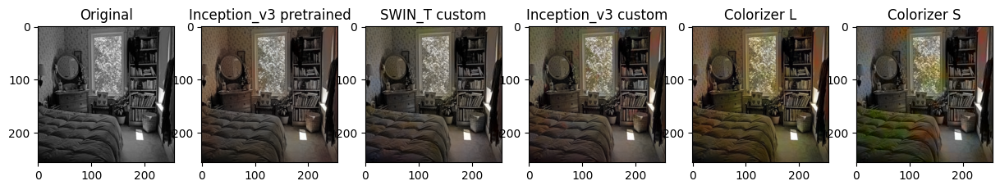

  2%|▏         | 1/50 [00:05<04:06,  5.02s/it]

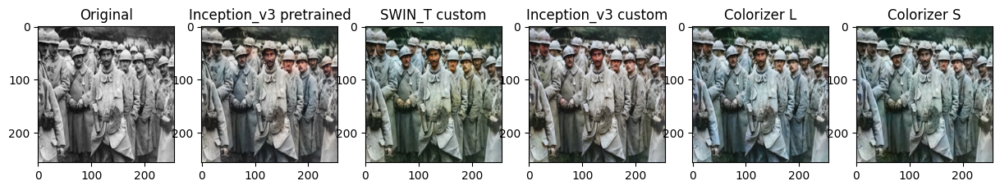

  4%|▍         | 2/50 [00:09<03:55,  4.91s/it]

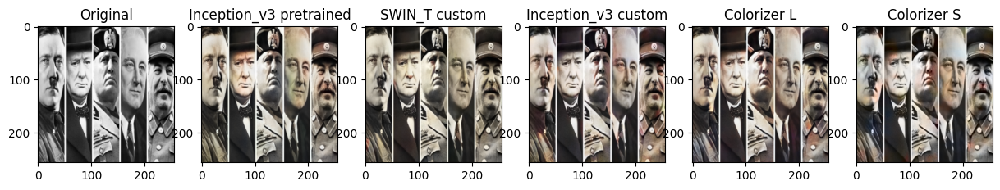

  6%|▌         | 3/50 [00:14<03:49,  4.88s/it]

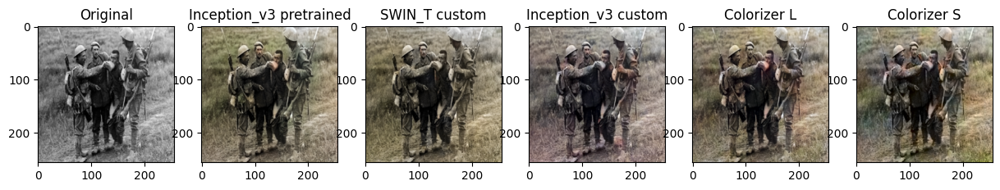

  8%|▊         | 4/50 [00:20<03:52,  5.07s/it]

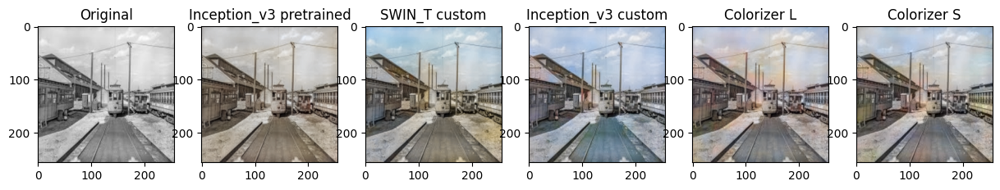

 10%|█         | 5/50 [00:25<03:49,  5.11s/it]

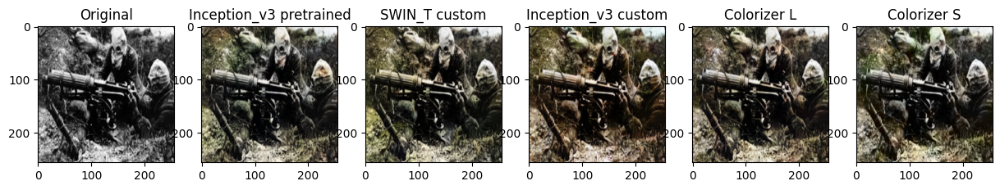

 12%|█▏        | 6/50 [00:30<03:40,  5.01s/it]

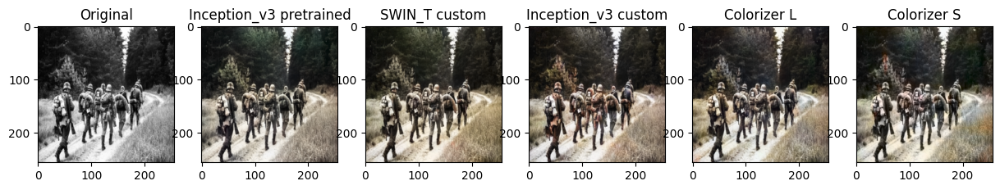

 14%|█▍        | 7/50 [00:34<03:32,  4.94s/it]

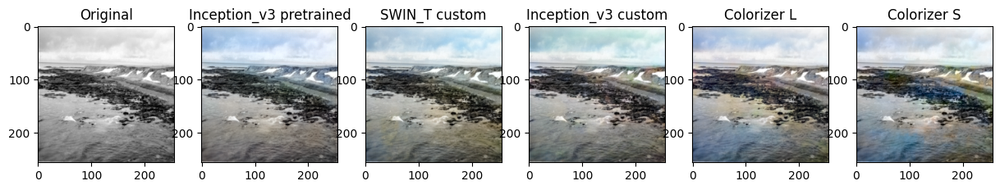

 16%|█▌        | 8/50 [00:39<03:26,  4.91s/it]

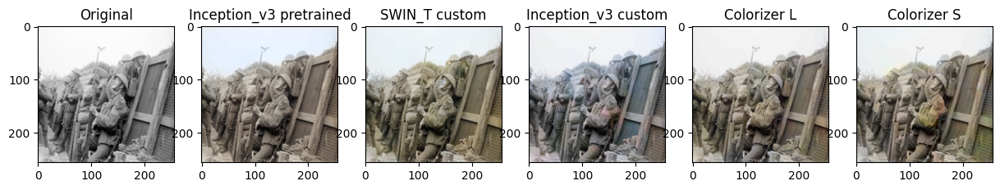

 18%|█▊        | 9/50 [00:44<03:19,  4.87s/it]<ipython-input-70-01e1b479fd9d>:66: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 8 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_img)


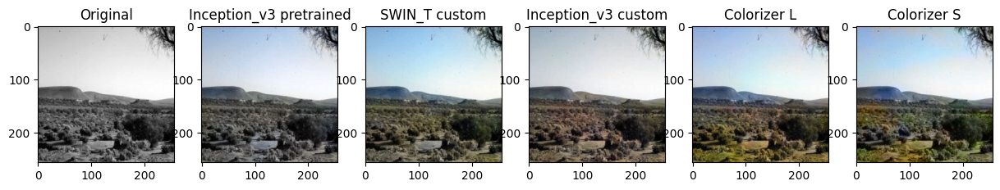

 20%|██        | 10/50 [00:49<03:13,  4.84s/it]

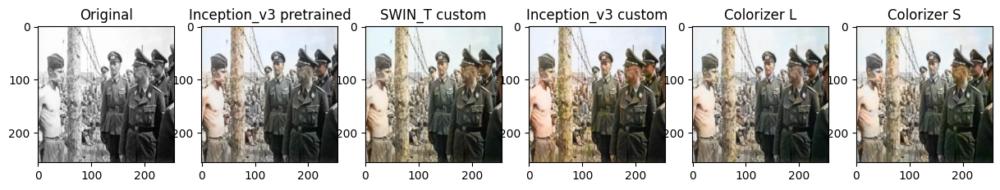

 22%|██▏       | 11/50 [00:54<03:18,  5.08s/it]

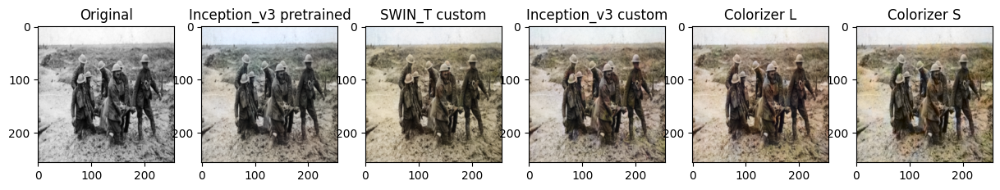

 24%|██▍       | 12/50 [00:59<03:09,  4.99s/it]

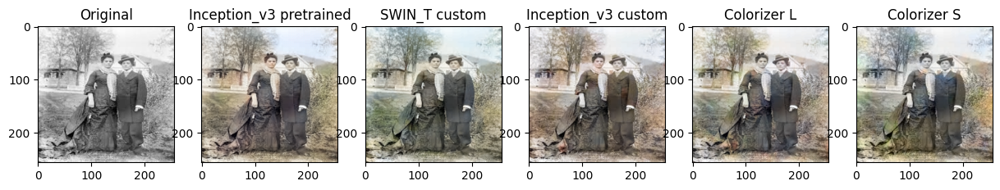

 26%|██▌       | 13/50 [01:04<03:02,  4.93s/it]

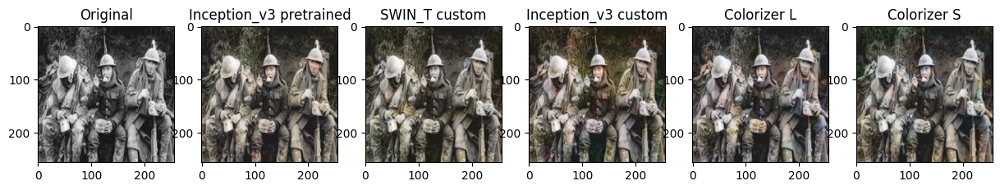

 28%|██▊       | 14/50 [01:09<02:56,  4.90s/it]

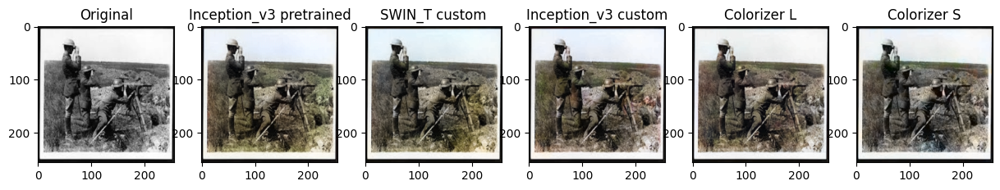

 30%|███       | 15/50 [01:14<02:50,  4.86s/it]

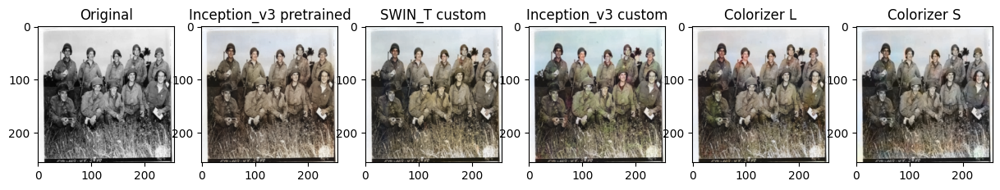

 32%|███▏      | 16/50 [01:18<02:44,  4.84s/it]

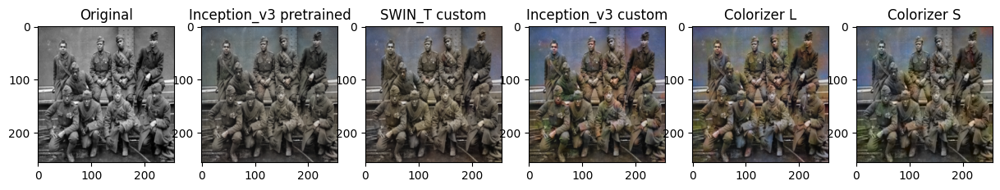

 34%|███▍      | 17/50 [01:24<02:46,  5.03s/it]

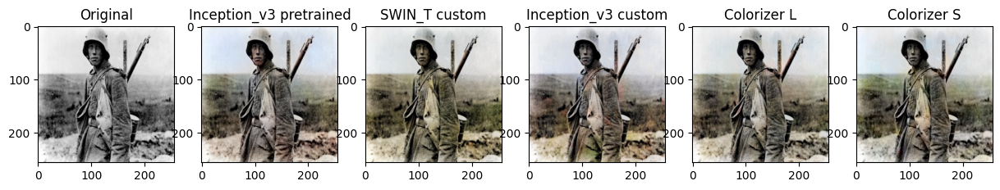

 36%|███▌      | 18/50 [01:29<02:41,  5.03s/it]

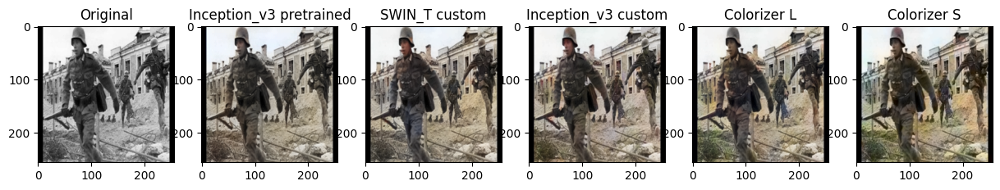

 38%|███▊      | 19/50 [01:34<02:33,  4.95s/it]

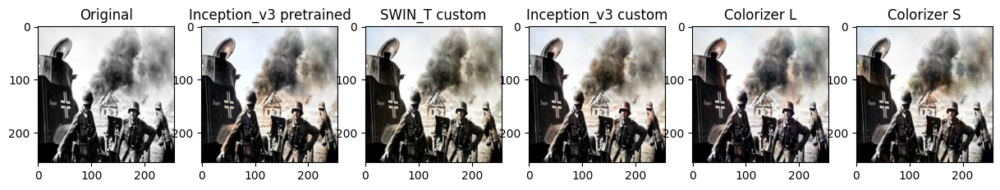

 40%|████      | 20/50 [01:38<02:25,  4.85s/it]

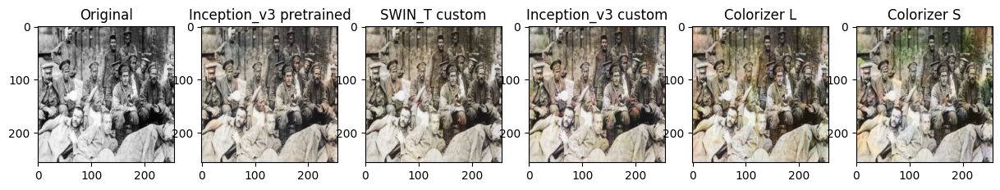

 42%|████▏     | 21/50 [01:43<02:18,  4.79s/it]

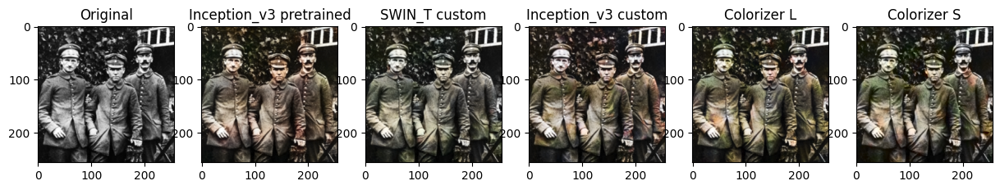

 44%|████▍     | 22/50 [01:48<02:12,  4.75s/it]

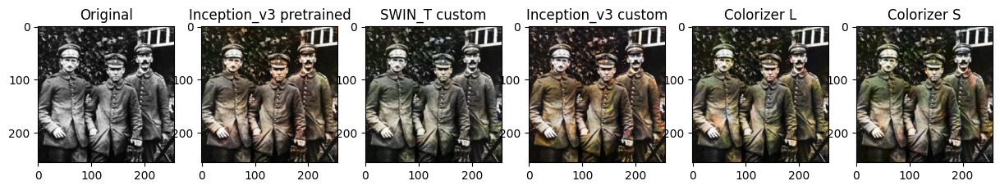

 46%|████▌     | 23/50 [01:52<02:07,  4.72s/it]

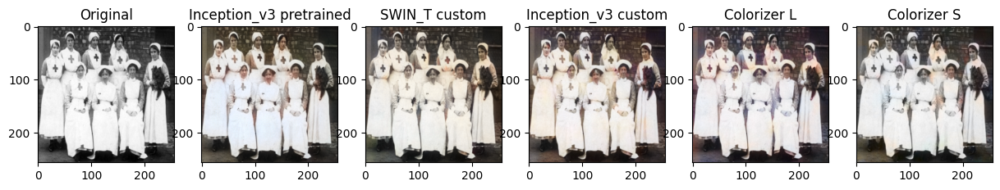

 48%|████▊     | 24/50 [01:58<02:09,  4.98s/it]

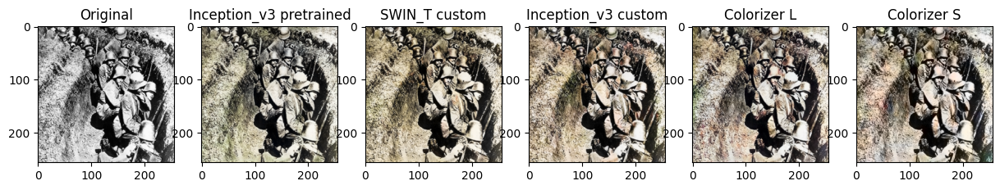

 50%|█████     | 25/50 [02:02<02:02,  4.91s/it]

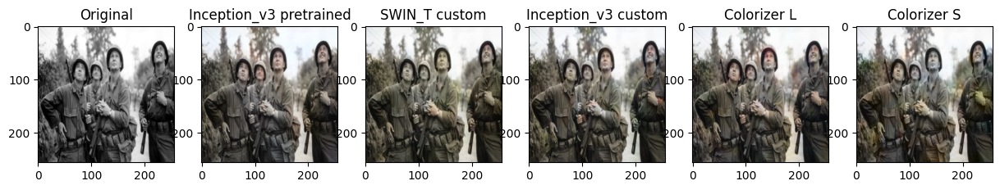

 52%|█████▏    | 26/50 [02:07<01:56,  4.85s/it]

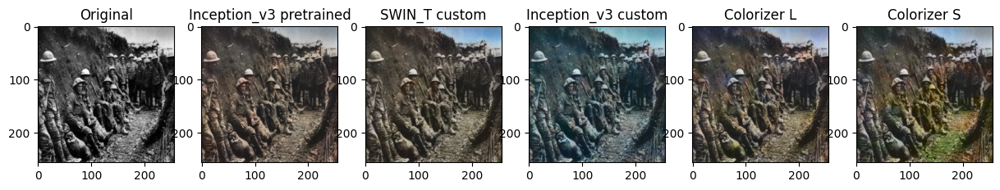

 54%|█████▍    | 27/50 [02:12<01:49,  4.78s/it]

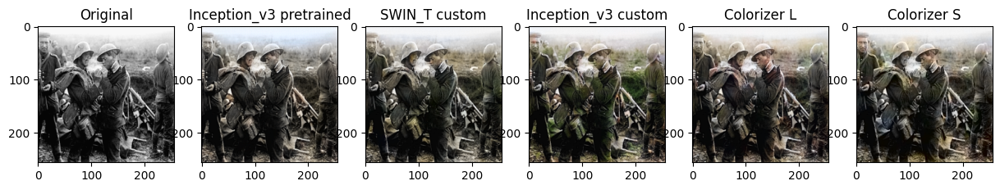

 56%|█████▌    | 28/50 [02:16<01:44,  4.74s/it]

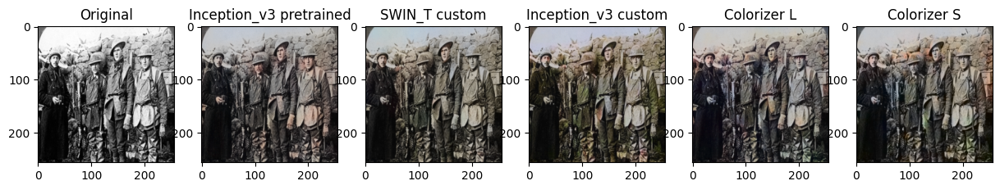

 58%|█████▊    | 29/50 [02:21<01:38,  4.70s/it]

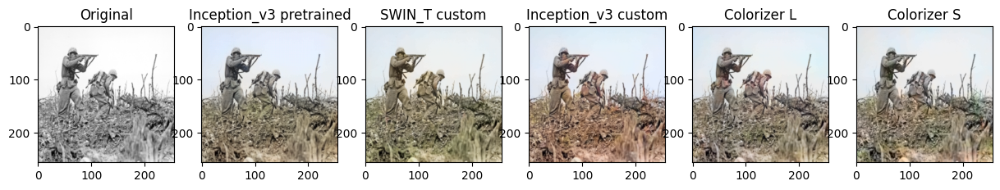

 60%|██████    | 30/50 [02:26<01:35,  4.78s/it]

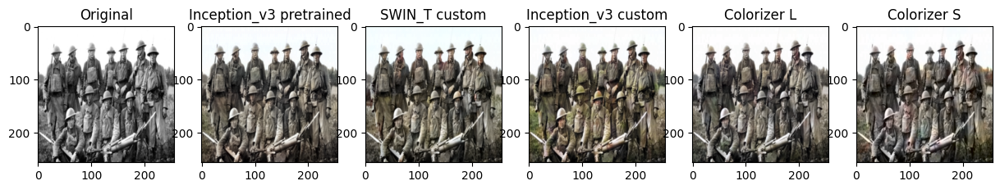

 62%|██████▏   | 31/50 [02:31<01:31,  4.81s/it]

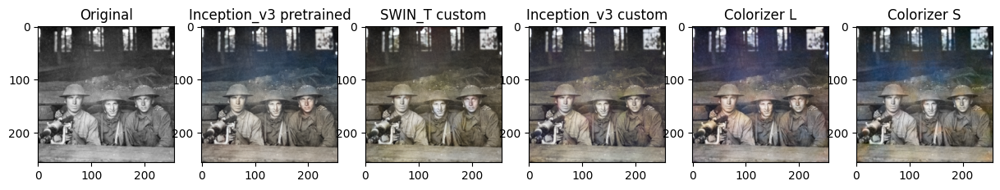

 64%|██████▍   | 32/50 [02:36<01:25,  4.77s/it]<ipython-input-70-01e1b479fd9d>:66: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  rgb_image = lab2rgb(lab_img)


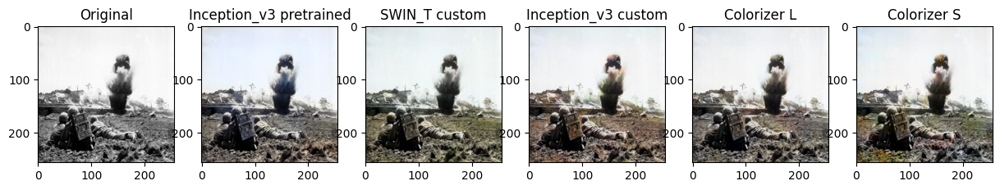

 66%|██████▌   | 33/50 [02:40<01:20,  4.71s/it]

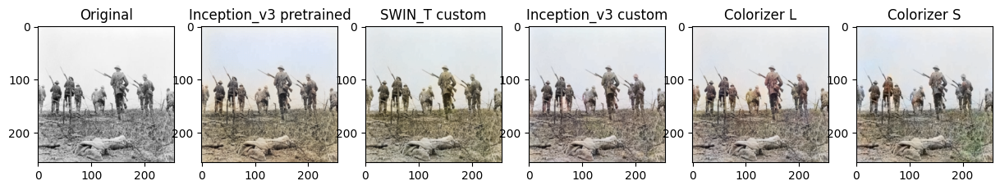

 68%|██████▊   | 34/50 [02:45<01:14,  4.67s/it]

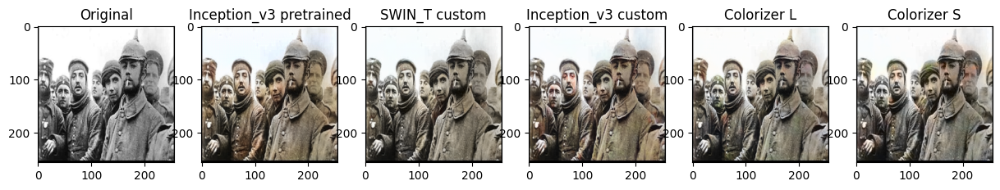

 70%|███████   | 35/50 [02:49<01:09,  4.63s/it]

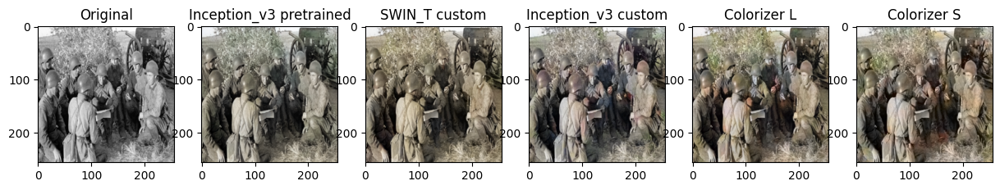

 72%|███████▏  | 36/50 [02:54<01:04,  4.63s/it]

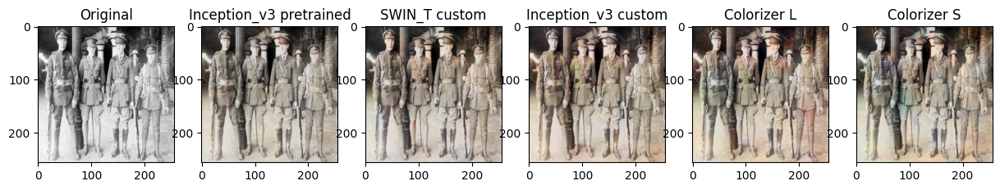

 74%|███████▍  | 37/50 [02:59<01:03,  4.90s/it]

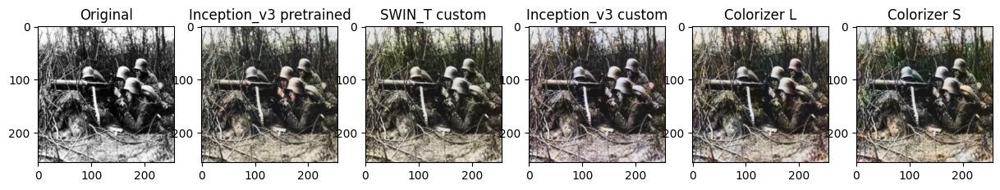

 76%|███████▌  | 38/50 [03:04<00:57,  4.83s/it]

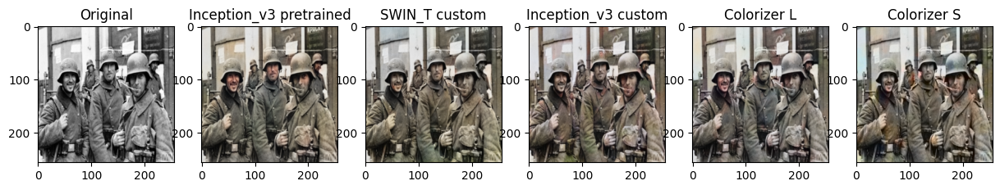

 78%|███████▊  | 39/50 [03:09<00:52,  4.77s/it]

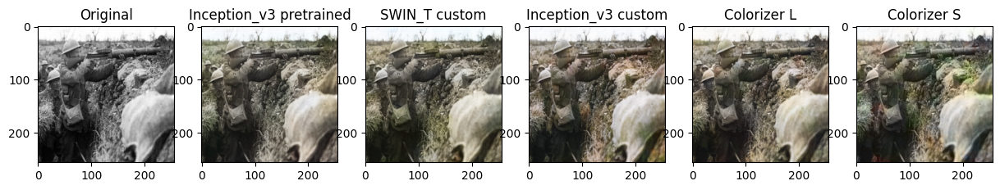

 80%|████████  | 40/50 [03:13<00:47,  4.73s/it]

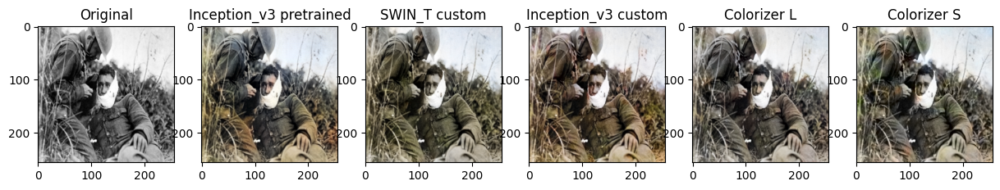

 82%|████████▏ | 41/50 [03:18<00:42,  4.70s/it]

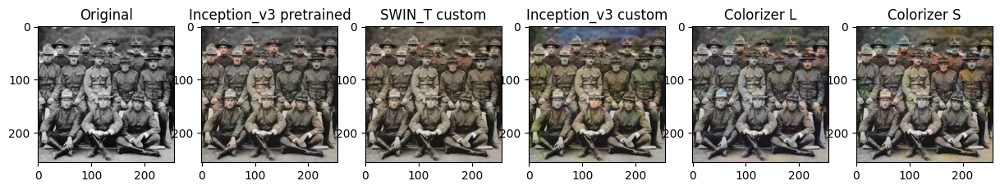

 84%|████████▍ | 42/50 [03:23<00:37,  4.66s/it]

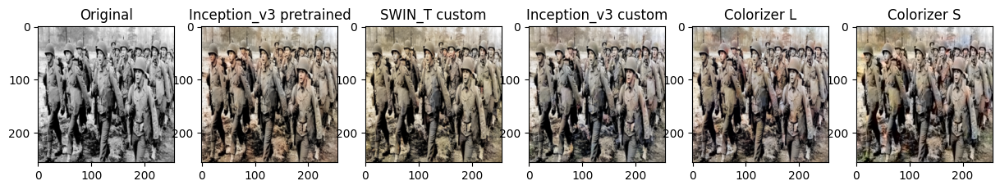

 86%|████████▌ | 43/50 [03:27<00:32,  4.67s/it]

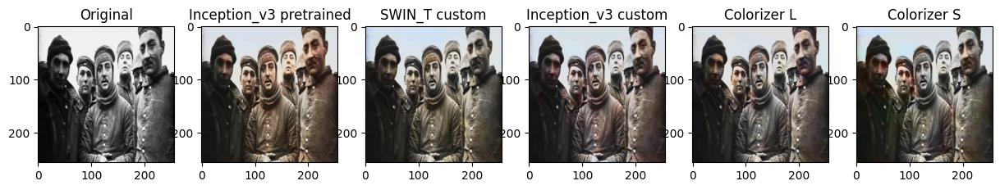

 88%|████████▊ | 44/50 [03:33<00:29,  4.92s/it]

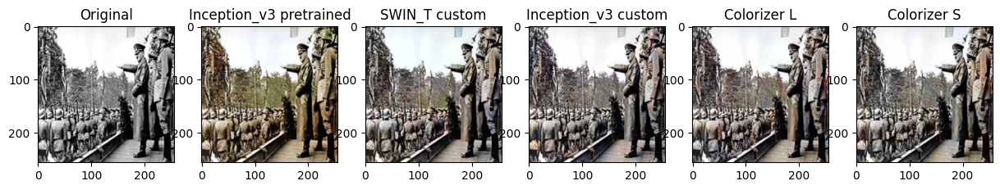

 90%|█████████ | 45/50 [03:37<00:24,  4.84s/it]

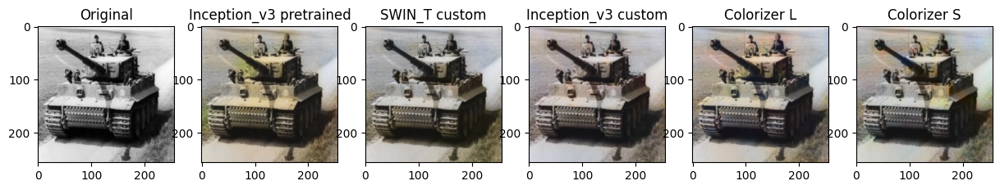

 92%|█████████▏| 46/50 [03:42<00:19,  4.76s/it]

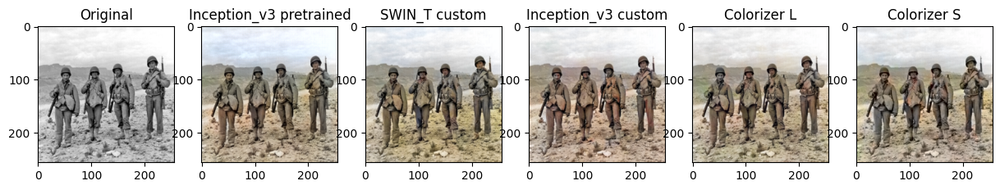

 94%|█████████▍| 47/50 [03:47<00:14,  4.72s/it]

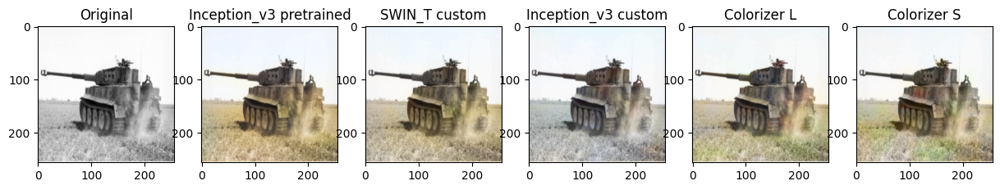

 96%|█████████▌| 48/50 [03:51<00:09,  4.67s/it]

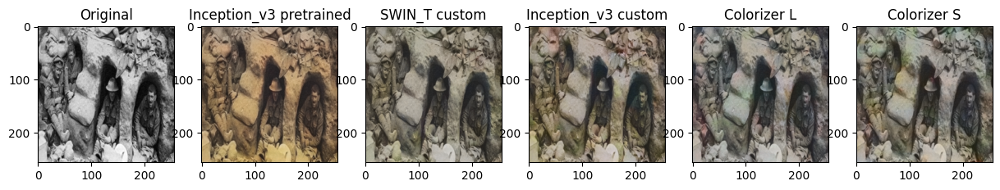

 98%|█████████▊| 49/50 [03:56<00:04,  4.66s/it]

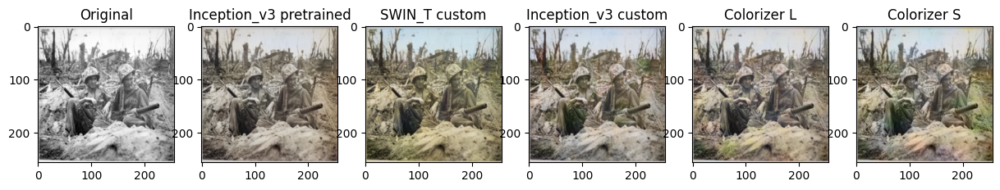

100%|██████████| 50/50 [04:01<00:00,  4.82s/it]


In [89]:
model_emb_dict = {
                model1: extractor1,
                model2: extractor2,
                model3: extractor3,
                model4: extractor3,
                model4: extractor3,
                model5: extractor3
            }


test_models(dl, model_emb_dict)